# Australian Rain Prediction
We have been approached by the Australian Metreological burea and have been presented with the rask of predicting if it will rain the following day and also give the certainity of the prediction.

Provided to us is historical data of 10 years fromm different places around Australia and the goal is to use the data to train a logistic regression model and make predictions with the validation and test set and also make the mdel be able to produce results that are ggo with test data.

### Objectives
* To download the data from an external source
* To do exploratory data analysis on the data
* To do data preprocessing like :
    1. oulier detection and possible deletions
    2. imputing missing numerical values 
    3. scalling the numerical inputs
    4. one hot encoding categorical inputs

* To split the data into training, validation and test sets
* Train the model 
* Test the model with accuracy score and confusion matrix on
    1. training set, 
    2. validation set 
    3. test set 
    4. dumb models

* Make a funtion to preprocess new inputs into the model and make predictions from the new inputs
* Give a final assement of the weaknesses and strengths of the model we have made using data from a confusion matrix.

### Exploratory Data Analysis and visulisation

In [1]:
#Inporting the ncessary libraries
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

%matplotlib inline

In [2]:
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (10,8)
sns.set_style('darkgrid')
matplotlib.rcParams['figure.facecolor'] = '#000000'


In [3]:
weather_df = pd.read_csv('weatherAUS.csv')

##### Checking for the correct data types for each column

In [4]:
weather_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Date           145460 non-null  object 
 1   Location       145460 non-null  object 
 2   MinTemp        143975 non-null  float64
 3   MaxTemp        144199 non-null  float64
 4   Rainfall       142199 non-null  float64
 5   Evaporation    82670 non-null   float64
 6   Sunshine       75625 non-null   float64
 7   WindGustDir    135134 non-null  object 
 8   WindGustSpeed  135197 non-null  float64
 9   WindDir9am     134894 non-null  object 
 10  WindDir3pm     141232 non-null  object 
 11  WindSpeed9am   143693 non-null  float64
 12  WindSpeed3pm   142398 non-null  float64
 13  Humidity9am    142806 non-null  float64
 14  Humidity3pm    140953 non-null  float64
 15  Pressure9am    130395 non-null  float64
 16  Pressure3pm    130432 non-null  float64
 17  Cloud9am       89572 non-null

In [5]:
weather_df.sample(5)

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
2823,2016-11-21,Albury,19.2,36.2,0.8,NaN,NaN,N,54.0,S,...,66.0,22.0,1015.6,1010.6,NaN,NaN,23.6,35.3,No,No
103164,2010-09-04,Nuriootpa,6.9,11.6,40.0,4.4,0.0,WSW,94.0,NNW,...,94.0,96.0,992.1,993.6,8.0,8.0,10.9,10.8,Yes,Yes
14579,2016-02-15,Moree,21.0,40.6,0.0,12.6,10.0,WSW,48.0,NNE,...,28.0,12.0,1009.6,1006.4,1.0,2.0,29.1,38.9,No,No
35255,2013-12-30,SydneyAirport,18.4,25.6,0.0,11.4,10.2,ENE,48.0,E,...,48.0,43.0,1015.4,1011.7,5.0,1.0,22.1,24.7,No,No
137088,2011-10-14,AliceSprings,22.5,37.6,0.0,15.0,11.5,S,52.0,WSW,...,15.0,6.0,1010.6,1008.6,5.0,2.0,29.6,36.3,No,No


#### We correct only the date object which has a wrong datatype.

In [6]:
weather_df['Date'] = pd.to_datetime(weather_df['Date'])

In [7]:
weather_df.Date.info()

<class 'pandas.core.series.Series'>
RangeIndex: 145460 entries, 0 to 145459
Series name: Date
Non-Null Count   Dtype         
--------------   -----         
145460 non-null  datetime64[ns]
dtypes: datetime64[ns](1)
memory usage: 1.1 MB


#### Anomaly/ outlier detection from the data

In [8]:
weather_df.describe()

,Date,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
count,145460,143975.000000,144199.000000,142199.000000,82670.000000,75625.000000,135197.000000,143693.000000,142398.000000,142806.000000,140953.000000,130395.00000,130432.000000,89572.000000,86102.000000,143693.000000,141851.00000
mean,2013-04-04 21:08:51.907053568,12.194034,23.221348,2.360918,5.468232,7.611178,40.035230,14.043426,18.662657,68.880831,51.539116,1017.64994,1015.255889,4.447461,4.509930,16.990631,21.68339
min,2007-11-01 00:00:00,-8.500000,-4.800000,0.000000,0.000000,0.000000,6.000000,0.000000,0.000000,0.000000,0.000000,980.50000,977.100000,0.000000,0.000000,-7.200000,-5.40000
25%,2011-01-11 00:00:00,7.600000,17.900000,0.000000,2.600000,4.800000,31.000000,7.000000,13.000000,57.000000,37.000000,1012.90000,1010.400000,1.000000,2.000000,12.300000,16.60000
50%,2013-06-02 00:00:00,12.000000,22.600000,0.000000,4.800000,8.400000,39.000000,13.000000,19.000000,70.000000,52.000000,1017.60000,1015.200000,5.000000,5.000000,16.700000,21.10000
75%,2015-06-14 00:00:00,16.900000,28.200000,0.800000,7.400000,10.600000,48.000000,19.000000,24.000000,83.000000,66.000000,1022.40000,1020.000000,7.000000,7.000000,21.600000,26.40000
max,2017-06-25 00:00:00,33.900000,48.100000,371.000000,145.000000,14.500000,135.000000,130.000000,87.000000,100.000000,100.000000,1041.00000,1039.600000,9.000000,9.000000,40.200000,46.70000
std,NaN,6.398495,7.119049,8.478060,4.193704,3.785483,13.607062,8.915375,8.809800,19.029164,20.795902,7.10653,7.037414,2.887159,2.720357,6.488753,6.93665


No anomalies were detected in the data.

### Data visualisation

We will visualize the data with our target column being rain tomorrow.

#### Data visualisation of the distributions


In [9]:
weather_df.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow'],
      dtype='object')

In [10]:
fig = px.histogram(
    weather_df,
    x='Date',
    color='RainTomorrow',
    marginal='box',
    title='Distribution of rain per year'
)
fig.show()

The rain tomorrow follows a patern that flauctuates up and down giving insight that we may need to include a column of month in the dataframe as it will give a fair approximation of the seasons.

In [11]:
weather_df['month']= pd.DatetimeIndex(weather_df['Date']).month

In [12]:
fig = px.histogram(
    weather_df,
    x='month',
    color='RainTomorrow',
    marginal='box',
    title='Distribution of rain per month'
)
fig.update_layout(bargap= 0.2)
fig.show()

Its is observed that rain tomorrow is increases from Jan to June and is highest in June and the decreases from June to Dec.

No rain tommorrow follows a fairly uniform distribution over every momnth.

In [13]:
fig = px.histogram(
    weather_df,
    x='Location',
    color='RainTomorrow',
    marginal='box',
    title='Distribution of rain per Loaction'
)
fig.update_layout(bargap= 0.1)
fig.show()

In [14]:

weather_df[weather_df['RainTomorrow'] == 'Yes'].groupby('Location')[['RainTomorrow']].count().sort_values('RainTomorrow',ascending =False).head(5)


,RainTomorrow
Location,
Portland,1095
Cairns,950
Walpole,949
Dartmoor,922
MountGambier,920


Its is observed that the top 5 places with the most rain tommorrow are:
* Portland	
* Cairns	
* Walpole	
* Dartmoor
* MountGambier

And those with the least rain tomorrow are:
* Uluru	
* Woomera	
* Nhil
* AliceSprings
* Katherine

In [15]:

weather_df[weather_df['RainTomorrow'] == 'Yes'].groupby('Location')[['RainTomorrow']].count().sort_values('RainTomorrow',ascending =True).head(5)


,RainTomorrow
Location,
Uluru,116
Woomera,202
Nhil,242
AliceSprings,244
Katherine,265


In [16]:
fig = px.histogram(
    weather_df,
    x='MinTemp',
    color='RainTomorrow',
    marginal='box',
    title='Distribution of rain over min temp'
)
fig.update_layout(bargap= 0.1)
fig.show()

Min temperature folllows a gausian Distribution
The higher the min temperature above 10 , the higher the chances of it raining tommorow.

In [17]:
fig = px.histogram(
    weather_df,
    x='MaxTemp',
    color='RainTomorrow',
    marginal='box',
    title='Distribution of rain over max temp'
)
fig.update_layout(bargap= 0.1)
fig.show()

Since the dataframe columns are too many to visualise to get meaningful insights , we shall make a correlation matrix for the numerical columns.

Columns with the highest correlation will bethe ones to be visulised to extract insights from the data.

In [18]:
raintomorrow_dict ={'Yes':1, 'No':0}
weather_df['RainTomorrow_Code']= weather_df['RainTomorrow'].map(raintomorrow_dict)

In [19]:
numeric_cols = weather_df.select_dtypes(include=np.number).columns.tolist()
numeric_cols

['MinTemp',
 'MaxTemp',
 'Rainfall',
 'Evaporation',
 'Sunshine',
 'WindGustSpeed',
 'WindSpeed9am',
 'WindSpeed3pm',
 'Humidity9am',
 'Humidity3pm',
 'Pressure9am',
 'Pressure3pm',
 'Cloud9am',
 'Cloud3pm',
 'Temp9am',
 'Temp3pm',
 'month',
 'RainTomorrow_Code']

<Axes: >

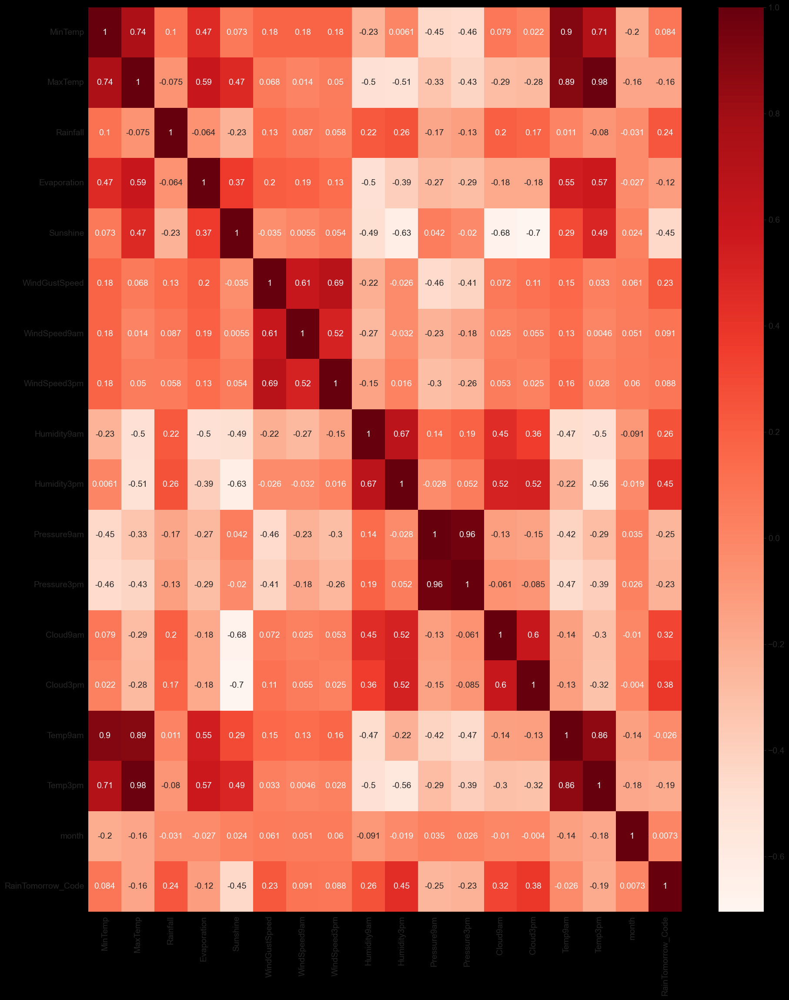

In [20]:
corr_matrix= weather_df[numeric_cols].corr()
plt.figure(figsize = (22,27))
sns.set_style('whitegrid')
sns.heatmap(data =corr_matrix,cmap='Reds',annot=True)


We shall therefore consider the following columns for distributions and relationships of Rain tomrrow:
* Cloud3pm
* cloud9am
* humidity3pm
* sunshine

In [21]:
fig = px.histogram(
    weather_df,
    x='Cloud3pm',
    color='RainTomorrow',
    marginal='box',
    title='Distribution of clouds at 3pm'
)
fig.update_layout(bargap= 0.1)
fig.show()

Chances of rain tomorrow increase exponentially as the cloud at 3pm increases from 0 to 8 with more chances of rain tomorrow when cloud at 3pm is at 8.

For no rain tomorrow, it is a bimodal distribution more information is needed on this behavioir, probably tow subsets of data exist here and may need to be seperated out for better model creation.

The same analysis applies to cloud at 9am

In [22]:
fig = px.histogram(
    weather_df,
    x='Cloud9am',
    color='RainTomorrow',
    marginal='box',
    title='Distribution of clouds at 9am'
)
fig.update_layout(bargap= 0.1)
fig.show()

In [23]:
fig = px.histogram(
    weather_df,
    x='Humidity3pm',
    color='RainTomorrow',
    marginal='box',
    title='Distribution of humidity at 3pm'
)
fig.update_layout(bargap= 0.1)
fig.show()

Distribution of humidity at 3pm for days when it rained the following day(rain tomorrow ) follows a skewed distribution to the right. This means there are higher chances of it raining the following day if humidity at 3pm exceeds 60.

In [24]:
fig = px.histogram(
    weather_df,
    x='Sunshine',
    color='RainTomorrow',
    marginal='box',
    title='Distribution of sunshine'
)
fig.update_layout(bargap= 0.1)
fig.show()

The distribution of sunshine on days when it rained the following day shows a skwed bimodal distribution. With a peak at 0 and another peak at 6 and a tail from 8 to 14.

The bimodality shows need to further split the sunshine recordings to account for the two subclusters so that more concrete explantions can be extracted from the data.

For days when it didn't rain the following day, the distribution is skwed towards the higher temperature , meaning the greater the sunshine recordings are for a particular day, the lower the chances of it raining the following day.

#### Data visualisation of the relations

The relations are with our target column of rain tomorrow and maybe rain today.


In [25]:
weather_df.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow', 'month', 'RainTomorrow_Code'],
      dtype='object')

In [26]:
fig = px.scatter(
    weather_df,
    x='month',
    y='Rainfall',
    color='RainTomorrow',
    title= 'Rainfall today vs month',
    opacity=0.8
)
#fig.update_layout(marker_size = 5)
fig.show()

In [27]:
fig = px.histogram(
    weather_df,
    x='month',
    y='Rainfall',
    color = 'RainTomorrow',
    title= 'Rainfall today vs month',
)
fig.update_layout(bargap = 0.1)
fig.show()

General distribution. The rainfall distribution is bimodal with a peak in March and another peak in June.

In [28]:
fig = px.histogram(
    weather_df,
    x='Cloud3pm',
    y='Rainfall',
    color='RainTomorrow',
    title= 'Rainfall today vs Coloud at 3pm',
    marginal='box',
)
fig.update_layout(bargap= 0.1)
fig.show()

Rainfall tomorrow increases exponrntially with increase in cloud at 3pm.

Most of the columns have discrete values which are not very informative when used with scatter plots hence the data visualisations in relatonships are already covered for the most part in the data visualisations of distributions.

### Data Preprocessing

In [29]:
weather_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 25 columns):
 #   Column             Non-Null Count   Dtype         
---  ------             --------------   -----         
 0   Date               145460 non-null  datetime64[ns]
 1   Location           145460 non-null  object        
 2   MinTemp            143975 non-null  float64       
 3   MaxTemp            144199 non-null  float64       
 4   Rainfall           142199 non-null  float64       
 5   Evaporation        82670 non-null   float64       
 6   Sunshine           75625 non-null   float64       
 7   WindGustDir        135134 non-null  object        
 8   WindGustSpeed      135197 non-null  float64       
 9   WindDir9am         134894 non-null  object        
 10  WindDir3pm         141232 non-null  object        
 11  WindSpeed9am       143693 non-null  float64       
 12  WindSpeed3pm       142398 non-null  float64       
 13  Humidity9am        142806 non-null  float64 

We have 145460 rows of data, we could decide to use a sample of the rows for basic tasks to lower memoery use and then afterwards apply the changes to the entire data set.

In [30]:
# use sample can be switched on and off
#use_sample = False
#sample_fraction = 0.4

#if use_sample:
#    weather_df = weather_df.sample(frac = sample_fraction).copy()
#else:
#    weather_df = weather_df.sample(frac = 1).copy()"

In [31]:
weather_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 25 columns):
 #   Column             Non-Null Count   Dtype         
---  ------             --------------   -----         
 0   Date               145460 non-null  datetime64[ns]
 1   Location           145460 non-null  object        
 2   MinTemp            143975 non-null  float64       
 3   MaxTemp            144199 non-null  float64       
 4   Rainfall           142199 non-null  float64       
 5   Evaporation        82670 non-null   float64       
 6   Sunshine           75625 non-null   float64       
 7   WindGustDir        135134 non-null  object        
 8   WindGustSpeed      135197 non-null  float64       
 9   WindDir9am         134894 non-null  object        
 10  WindDir3pm         141232 non-null  object        
 11  WindSpeed9am       143693 non-null  float64       
 12  WindSpeed3pm       142398 non-null  float64       
 13  Humidity9am        142806 non-null  float64 

Splitting our data into train ,validation and testing datasets if it were not time series data

In [32]:
from sklearn.model_selection import train_test_split

train_val_df, test_df = train_test_split(weather_df,test_size=0.2,random_state=42)
train_df,val_df = train_test_split(train_val_df,test_size=0.25,random_state=42)

In [33]:
print(f'Train df: {train_df.shape}')
print(f'Validation df: {val_df.shape}')
print(f'Test df: {test_df.shape}')

Train df: (87276, 25)
Validation df: (29092, 25)
Test df: (29092, 25)


For time series data , we will split the dataset based on years, so that model is trained on old data, validated on recent data and tested on the most recent data.

<Axes: title={'center': 'No. of rows per year'}, xlabel='Date', ylabel='count'>

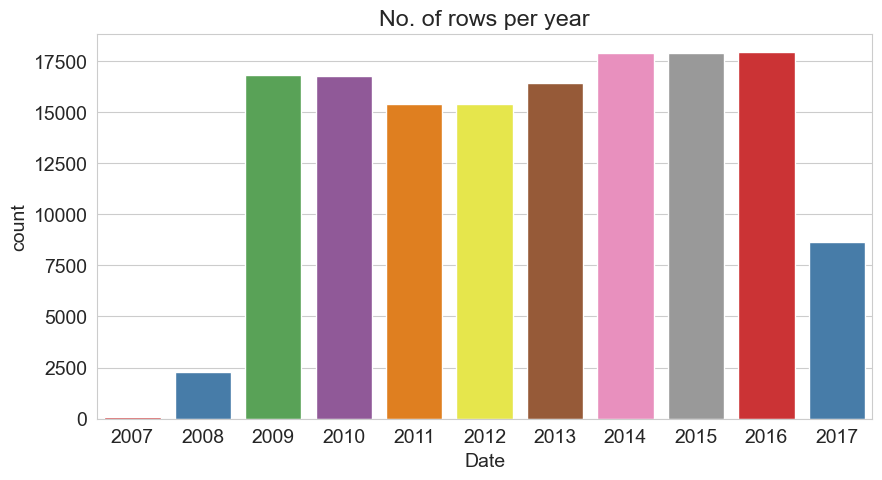

In [34]:
plt.figure(figsize=(10,5))
plt.title('No. of rows per year')
weather_years =pd.DatetimeIndex(weather_df['Date']).year
sns.countplot(x=weather_years,hue=weather_years,legend=False, palette='Set1')

we will therefore use:
* 2007-2013 for training
* 2014-2015 for validation
* 2016-2017 for testing



In [35]:
weather_df['Year'] = pd.DatetimeIndex(weather_df['Date']).year

In [36]:
train_df =weather_df[weather_df.Year <= 2014].copy()
val_df = weather_df[(weather_df.Year == 2015)].copy()
test_df= weather_df[weather_df.Year >=2016].copy()

In [37]:
print(f'Train df: {train_df.shape}')
print(f'Validation df: {val_df.shape}')
print(f'Test df: {test_df.shape}')

Train df: (101018, 26)
Validation df: (17885, 26)
Test df: (26557, 26)


In [38]:
total_rows = 83133 + 35770 + 26557
print(f'Percenatge Train df = {(101018/total_rows)*100}')
print(f'Percenatge Validation df = {(17885/total_rows)*100}')
print(f'Percenatge Train df = {(26557/total_rows)*100}')

Percenatge Train df = 69.44727072734771
Percenatge Validation df = 12.295476419634262
Percenatge Train df = 18.25725285301801


In [39]:
weather_df.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow', 'month', 'RainTomorrow_Code',
       'Year'],
      dtype='object')

Cleaning the dataframe to remove columns that wont be needed

In [40]:
weather_df.drop(columns=['RainTomorrow_Code','Year'], inplace = True)

In [41]:
input_cols_raw=['Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'month']
target_cols='RainTomorrow'

Now that we have the raw inputs list, next part is to seperate them into numeric cols for scaling and categorical cols for one hot encoding

In [42]:
numeric_cols= weather_df.select_dtypes(include = np.number).columns.tolist()
numeric_cols

['MinTemp',
 'MaxTemp',
 'Rainfall',
 'Evaporation',
 'Sunshine',
 'WindGustSpeed',
 'WindSpeed9am',
 'WindSpeed3pm',
 'Humidity9am',
 'Humidity3pm',
 'Pressure9am',
 'Pressure3pm',
 'Cloud9am',
 'Cloud3pm',
 'Temp9am',
 'Temp3pm',
 'month']

In [44]:
categorical_cols= weather_df.select_dtypes('object').columns.tolist()[:-1]
categorical_cols

['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday']

Imputation of missing data and then scaling the inputs and then encoding.